# Packages Import

In [1]:
import tensorflow as tf
import os
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from utils.labels import map_class_to_rgb, adjust_mask
import segmentation_models as sm
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
from utils.util import *



C:\Users\20100\anaconda3\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
C:\Users\20100\anaconda3\lib\site-packages\numpy\.libs\libopenblas.WCDJNK7YVMPZQ2ME2ZZHJJRJ3JIKNDB7.gfortran-win_amd64.dll
C:\Users\20100\anaconda3\lib\site-packages\numpy\.libs\libopenblas.XWYDX2IKJW2NMTWSFYNGFUWKQU3LYTCZ.gfortran-win_amd64.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


Segmentation Models: using `keras` framework.


# Paths and Constants

In [2]:
##### paths


base_data_dir = 'data'
saved_models = 'checkpoint'

train_path = os.path.join(base_data_dir, 'data')
test_path = os.path.join(base_data_dir, 'testing')

classes_path = os.path.join(base_data_dir, 'classes.csv')


iti_data_dir = os.path.join(base_data_dir, 'aroundITI')
single_frames_dir = os.path.join(base_data_dir, 'single_frames')
videos_dir = os.path.join(base_data_dir, 'videos')

output_images_dir = os.path.join(base_data_dir, 'output_images')
output_videos_dir = os.path.join(base_data_dir, 'output_videos')



## parmeters

batch_sz =8
num_classes = 31
DIM=288
seed = 1







# Read Labels file

In [3]:
classes = pd.read_csv(classes_path,index_col='name')

# data generators

In [4]:
# Data generator
train_generator_fn, val_generator_fn, train_length, validation_length = train_valid_generator(train_path, seed, batch_sz, DIM)

Found 662 images belonging to 1 classes.
Found 662 images belonging to 1 classes.
Found 38 images belonging to 1 classes.
Found 38 images belonging to 1 classes.


# Model (change here)

In [22]:
sm.set_framework('tf.keras')

model = sm.PSPNet('inceptionv3', encoder_weights='imagenet', input_shape=(DIM,DIM,3),activation='softmax' 
, classes=31 , encoder_freeze=False, psp_dropout=0.5,psp_use_batchnorm=True)


In [23]:
# model.summary()
# model.__dict__

# freeze layers (optional)

In [24]:
## xception exit_flow_block2_separable_conv1_depthwise
## mobilenetv2 expanded_conv_16_project

# freeze_model_layers(model,'exit_flow_block2_separable_conv1_depthwise')

# model.summary()

# model compilation and fitting (you may change here if needed)

In [25]:
from tensorflow.python.keras.optimizers import adam_v2

model_name='PSP'

cp_name = os.path.join(saved_models,
                            model_name+'_epoch_{epoch:03d}_valLoss_{val_loss:.4f}.h5')

model_checkpoint = ModelCheckpoint(filepath=cp_name
                                   , monitor='val_loss',verbose=1, save_best_only=True)
reduce_lr = ReduceLROnPlateau(
    monitor = "val_loss", 
    patience = 20,
    verbose = 1, 
    factor = 0.2, 
    min_lr = 0.000001,
)


model.compile(
    optimizer= tf.keras.optimizers.Adam(learning_rate=1e-4),
    # optimizer='Nadam',
    loss=sm.losses.cce_jaccard_loss,
    metrics=[sm.metrics.iou_score],
    
)

history = model.fit(
    train_generator_fn(),
    steps_per_epoch=train_length // batch_sz
  , validation_steps=validation_length // batch_sz,
   epochs=100,
   validation_data= val_generator_fn(),  
   callbacks=[model_checkpoint,reduce_lr]
)




Epoch 1/100
82/82 [==============================] - ETA: 0s - loss: 0.9642 - iou_score: 0.0860
Epoch 00001: val_loss improved from inf to 1.00500, saving model to checkpoint\PSP_epoch_001_valLoss_1.0050.h5
82/82 [==============================] - 125s 2s/step - loss: 0.9642 - iou_score: 0.0860 - val_loss: 1.0050 - val_iou_score: 0.0493 - lr: 1.0000e-04
Epoch 2/100
82/82 [==============================] - ETA: 0s - loss: 0.9046 - iou_score: 0.1301
Epoch 00002: val_loss improved from 1.00500 to 0.96144, saving model to checkpoint\PSP_epoch_002_valLoss_0.9614.h5
82/82 [==============================] - 125s 2s/step - loss: 0.9046 - iou_score: 0.1301 - val_loss: 0.9614 - val_iou_score: 0.0849 - lr: 1.0000e-04
Epoch 3/100
82/82 [==============================] - ETA: 0s - loss: 0.8816 - iou_score: 0.1502
Epoch 00003: val_loss improved from 0.96144 to 0.93083, saving model to checkpoint\PSP_epoch_003_valLoss_0.9308.h5
82/82 [==============================] - 125s 2s/step - loss: 0.8816 - io

82/82 [==============================] - ETA: 0s - loss: 0.7006 - iou_score: 0.3192
Epoch 00053: val_loss did not improve from 0.77181
82/82 [==============================] - 114s 1s/step - loss: 0.7006 - iou_score: 0.3192 - val_loss: 0.8277 - val_iou_score: 0.2153 - lr: 1.0000e-04
Epoch 54/100
82/82 [==============================] - ETA: 0s - loss: 0.6970 - iou_score: 0.3226
Epoch 00054: val_loss did not improve from 0.77181
82/82 [==============================] - 113s 1s/step - loss: 0.6970 - iou_score: 0.3226 - val_loss: 0.7938 - val_iou_score: 0.2374 - lr: 1.0000e-04
Epoch 55/100
82/82 [==============================] - ETA: 0s - loss: 0.6950 - iou_score: 0.3248
Epoch 00055: val_loss did not improve from 0.77181
82/82 [==============================] - 114s 1s/step - loss: 0.6950 - iou_score: 0.3248 - val_loss: 0.8012 - val_iou_score: 0.2464 - lr: 1.0000e-04
Epoch 56/100
82/82 [==============================] - ETA: 0s - loss: 0.6938 - iou_score: 0.3264
Epoch 00056: val_loss did

Epoch 80/100
82/82 [==============================] - ETA: 0s - loss: 0.6670 - iou_score: 0.3514
Epoch 00080: val_loss did not improve from 0.73686
82/82 [==============================] - 114s 1s/step - loss: 0.6670 - iou_score: 0.3514 - val_loss: 0.7961 - val_iou_score: 0.2462 - lr: 2.0000e-05
Epoch 81/100
82/82 [==============================] - ETA: 0s - loss: 0.6710 - iou_score: 0.3481
Epoch 00081: val_loss did not improve from 0.73686
82/82 [==============================] - 115s 1s/step - loss: 0.6710 - iou_score: 0.3481 - val_loss: 0.8174 - val_iou_score: 0.2419 - lr: 2.0000e-05
Epoch 82/100
82/82 [==============================] - ETA: 0s - loss: 0.6702 - iou_score: 0.3490
Epoch 00082: val_loss did not improve from 0.73686
82/82 [==============================] - 115s 1s/step - loss: 0.6702 - iou_score: 0.3490 - val_loss: 0.8119 - val_iou_score: 0.2351 - lr: 2.0000e-05
Epoch 83/100
82/82 [==============================] - ETA: 0s - loss: 0.6654 - iou_score: 0.3529
Epoch 00083:

# plotting loss and MeanIou

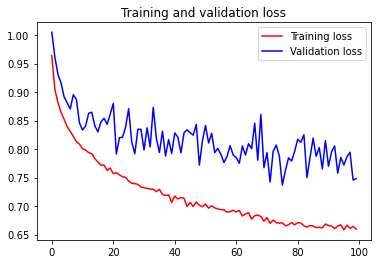

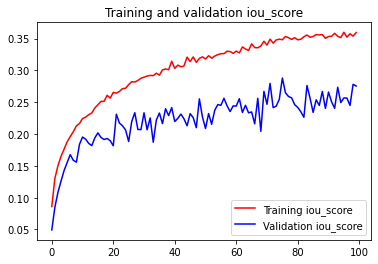

In [26]:
%matplotlib inline
import matplotlib.pyplot as plt
loss = history.history['loss']
val_loss = history.history['val_loss']
iou_score = history.history['iou_score']
val_iou_score = history.history['val_iou_score']

epochs = range(len(loss))

plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.figure()

plt.plot(epochs, iou_score, 'r', label='Training iou_score')
plt.plot(epochs, val_iou_score, 'b', label='Validation iou_score')
plt.title('Training and validation iou_score')
plt.legend()

plt.show()

# loading Created Model

In [30]:
from keras.models import load_model

model = load_model(filepath='checkpoint/PSP_epoch_076_valLoss_0.7369.h5', custom_objects={
    "categorical_crossentropy_plus_jaccard_loss":sm.losses.cce_jaccard_loss
    ,"iou_score":sm.metrics.iou_score})

# predicting Validation data

C:\Users\20100\Desktop\ITI\GP\data_semantics\github repo\semantic-segmentation\utils\util.py:263: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 4, figsize=(16, 16))


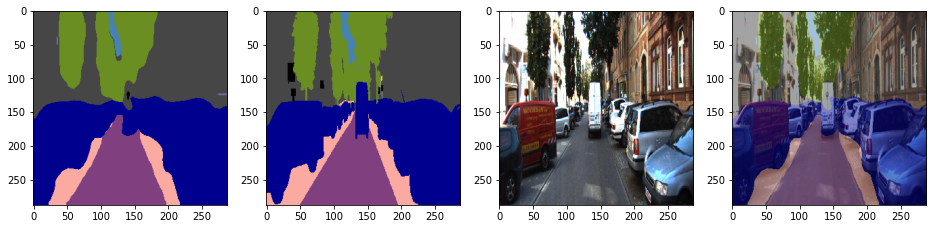

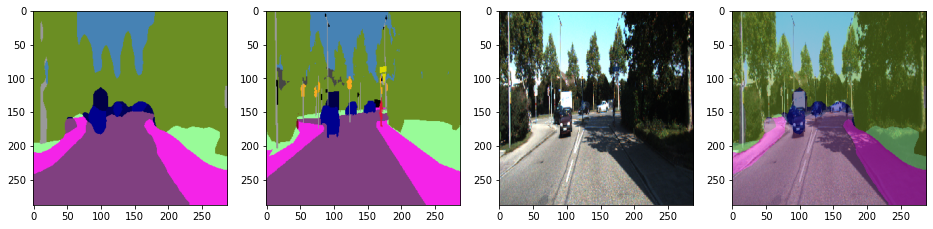

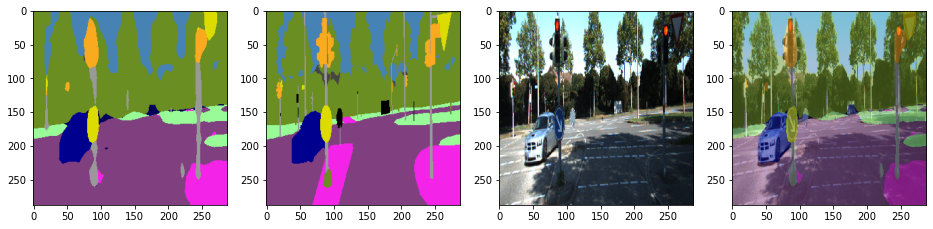

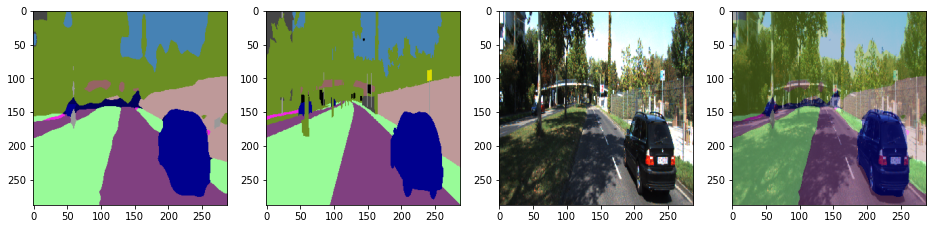

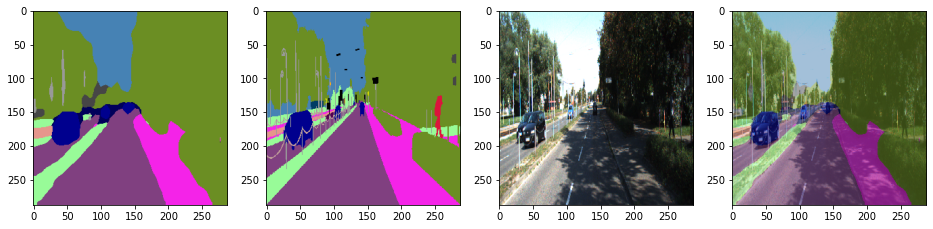

...

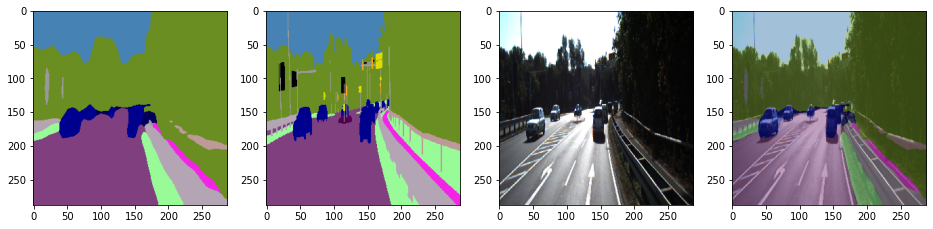

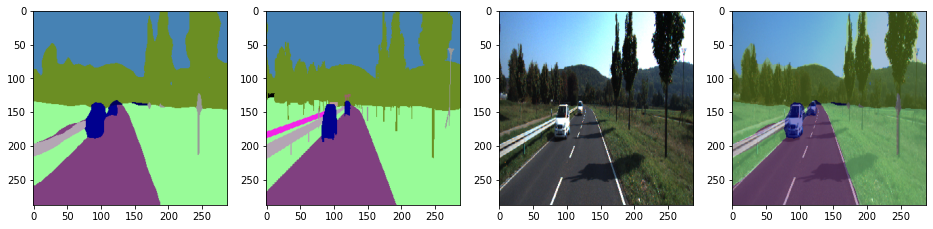

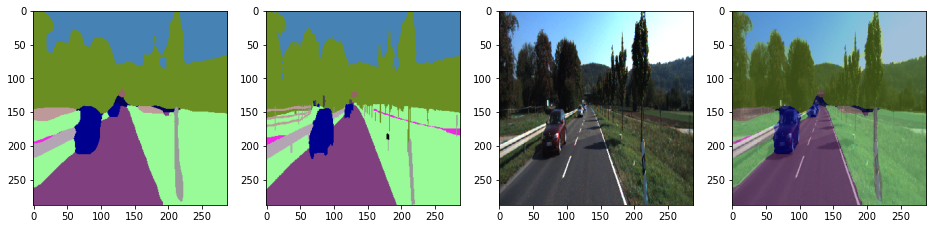

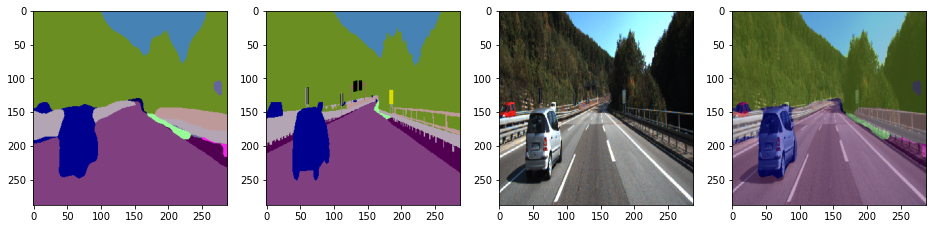

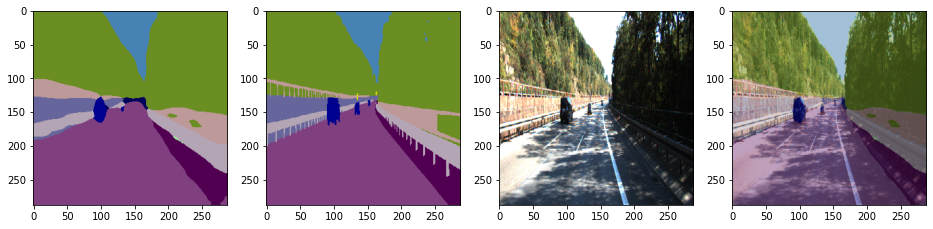

In [31]:
plot_predictions (train_path,model,DIM,mode='valid')

# predicting test data

C:\Users\20100\Desktop\ITI\GP\data_semantics\github repo\semantic-segmentation\utils\util.py:281: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 3, figsize=(16, 16))


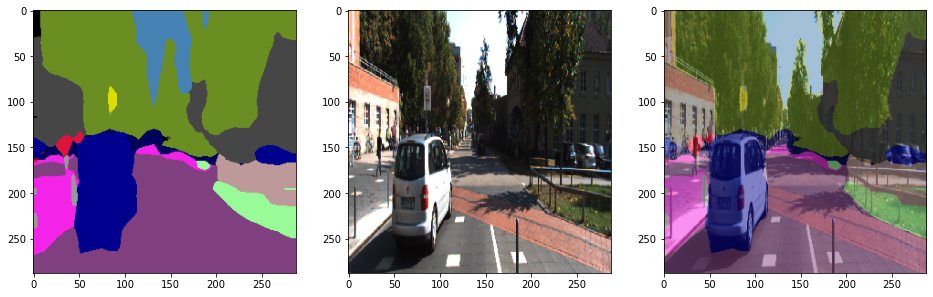

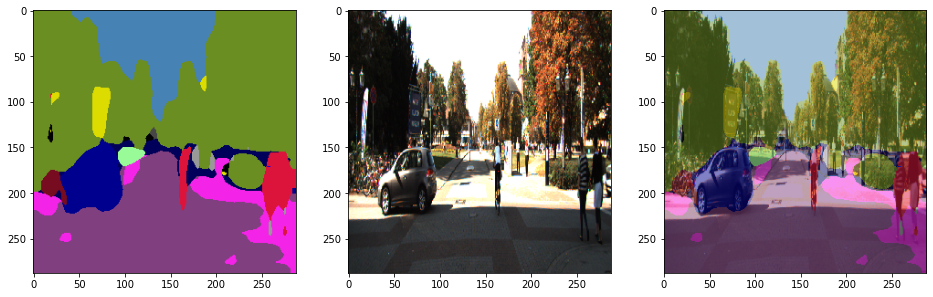

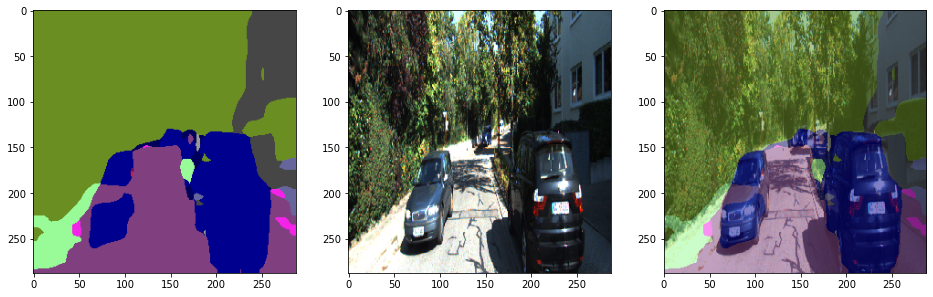

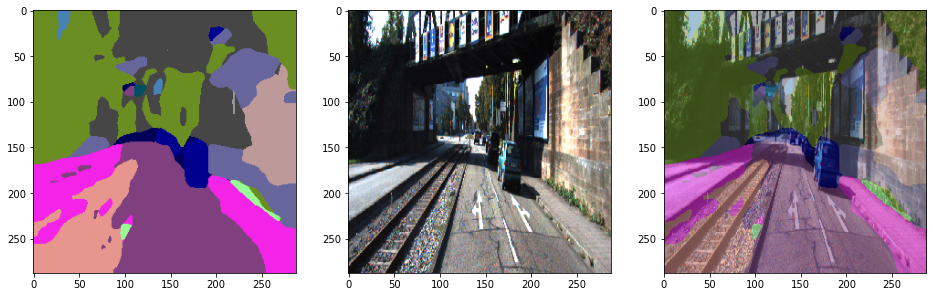

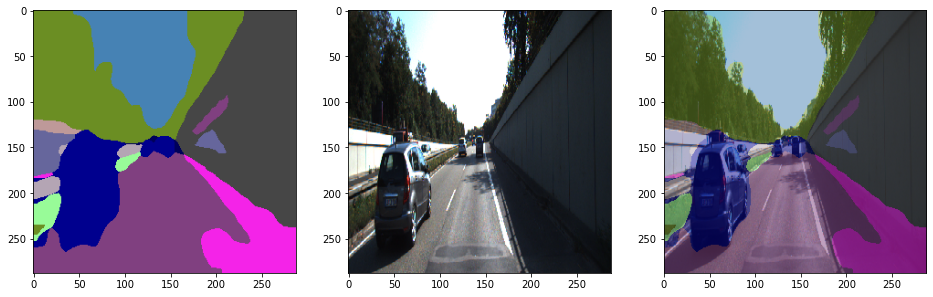

...

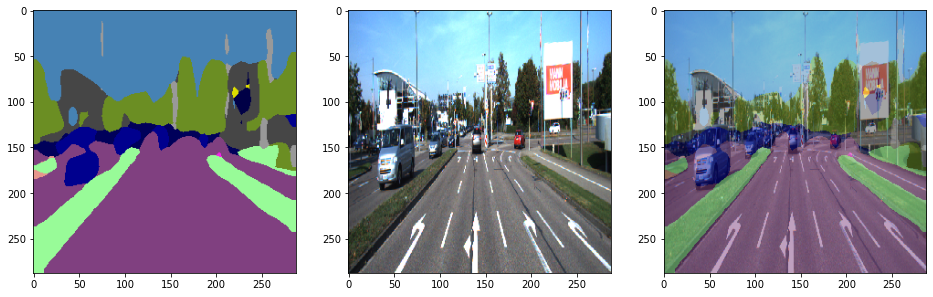

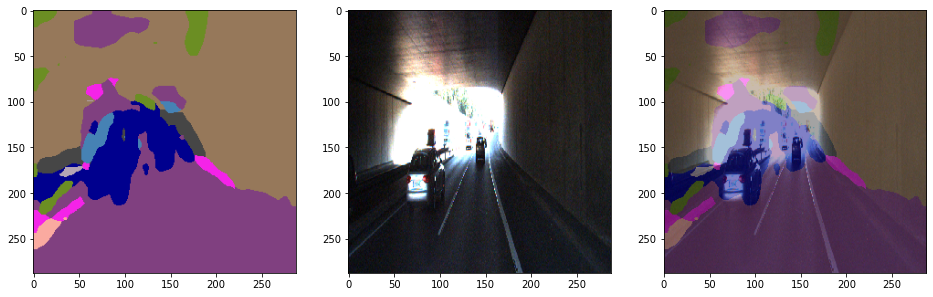

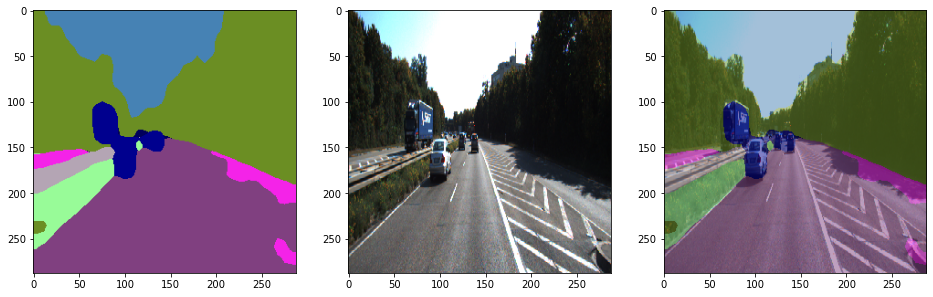

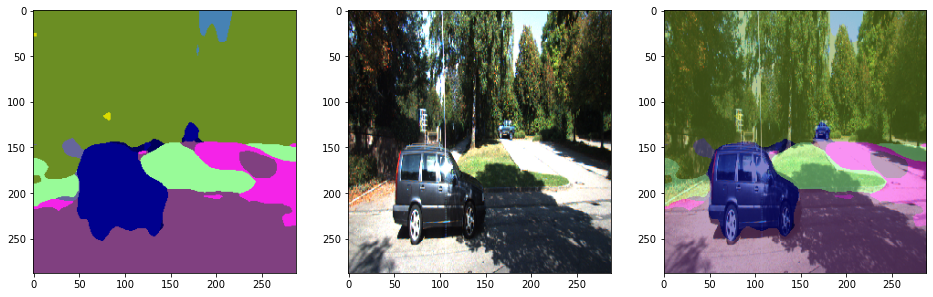

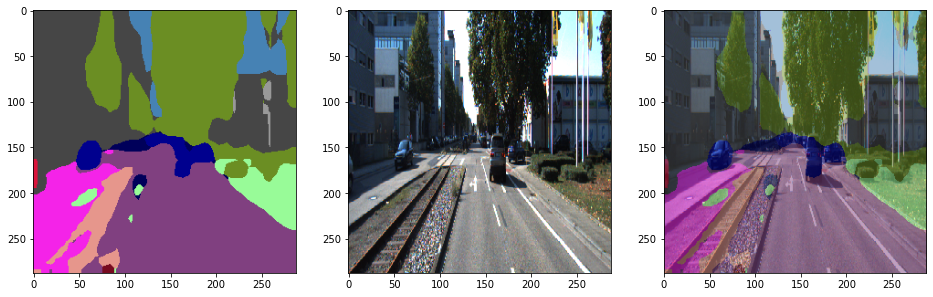

In [32]:
plot_predictions (test_path,model,DIM,mode='testing',test_sample_size=30)

# predicting ITI Data

C:\Users\20100\Desktop\ITI\GP\data_semantics\github repo\semantic-segmentation\utils\util.py:296: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 3, figsize=(16, 16))


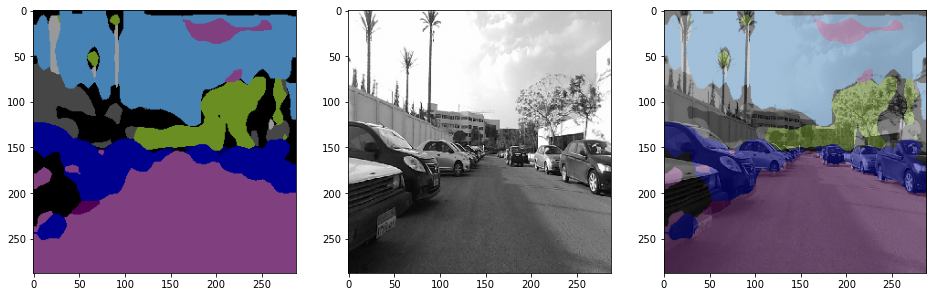

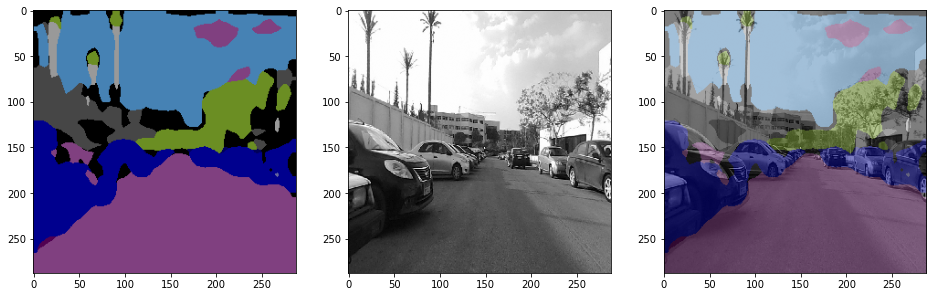

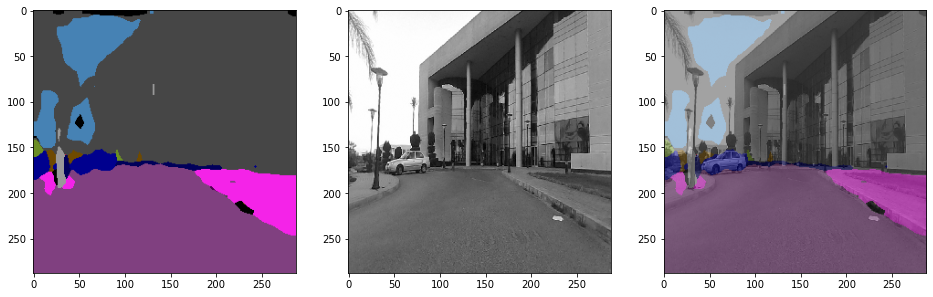

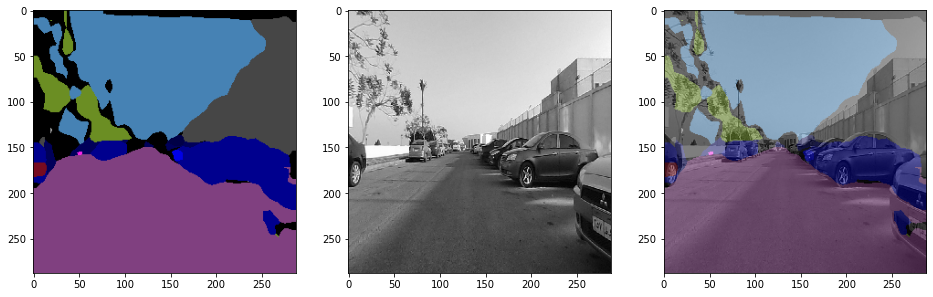

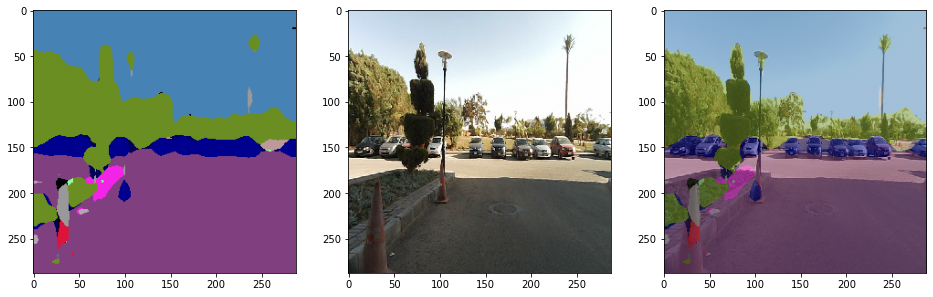

...

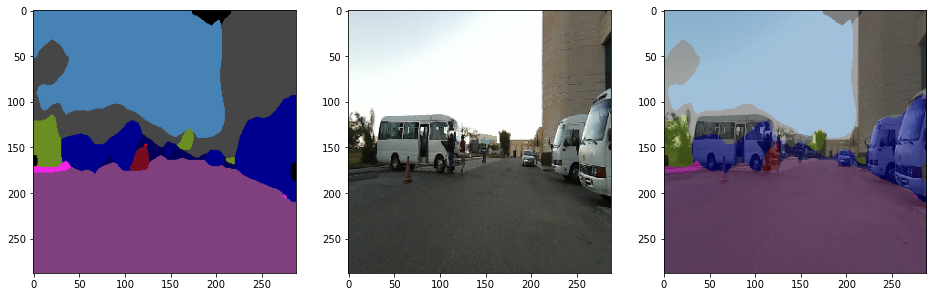

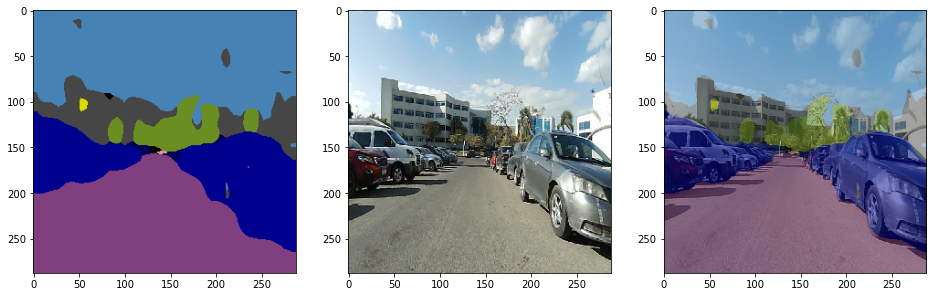

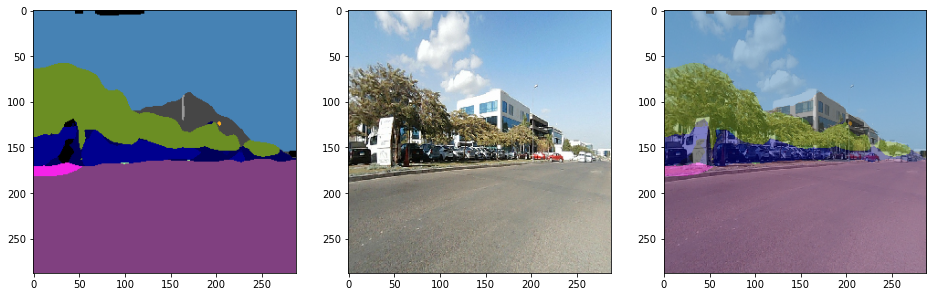

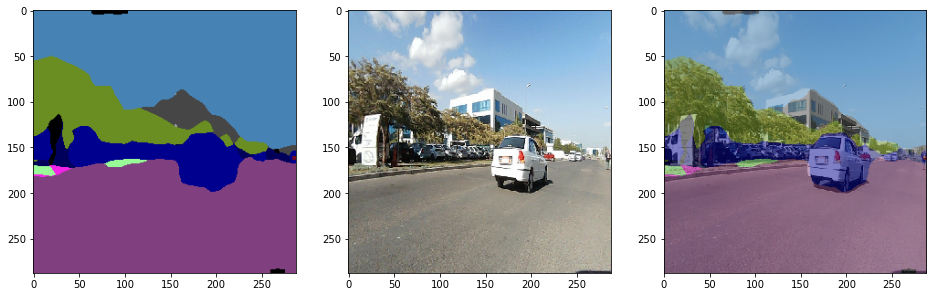

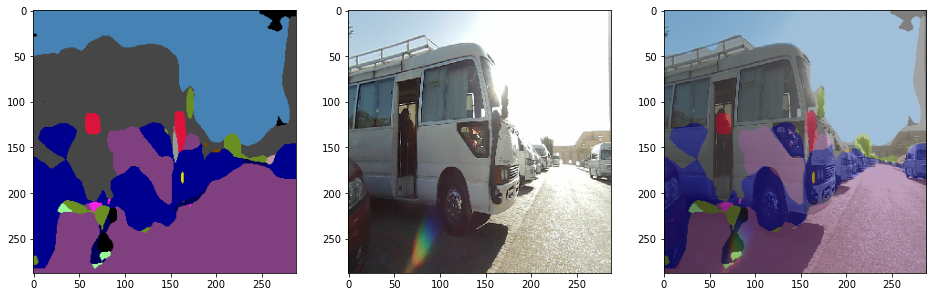

In [33]:
plot_predictions (iti_data_dir,model,DIM,mode='ITI')